In [ ]:
#import keras
from sklearn.model_selection import train_test_split
from keras.models import Model
from keras.layers import Input, concatenate, Conv2D, MaxPooling2D, UpSampling2D, BatchNormalization, Dropout, Lambda, Conv2DTranspose
from keras.optimizers import Adam
import numpy as np
import cv2
import os
from keras.applications.vgg16 import preprocess_input
from keras.callbacks import ModelCheckpoint
import matplotlib.pyplot as plt
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import load_model
import time
from tensorflow.keras import layers, models, regularizers, optimizers
import imageio.v2 as imageio  # Use the v2 module to avoid deprecation warnings
from skimage.transform import resize
import gc  # For garbage collection
import re
#from tensorflow.keras.applications import ResNet50
from keras.applications import MobileNetV2
import tensorflow as tf

In [ ]:
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')

# Access files from Drive
file_path = '/content/drive/MyDrive/FYP/train2'
# List the contents of the "images" folder
images_folder_path = os.path.join(file_path, 'images')
image_files = os.listdir(images_folder_path)


Mounted at /content/drive


In [ ]:
import numpy as np
import cv2
from keras.utils import to_categorical

def preprocess_mask(masks, num_classes=3):
    processed_masks = []
    class_colors = {
        0: (0, 0, 0),       # Background (Black)
        1: (255, 0, 0),     # Cracks (Red)
        2: (0, 255, 0)      # Potholes (Green)
    }
    num = 1

    for mask in masks:
        # Convert RGB mask to integer label mask
        int_mask = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.int32)

        # Define ranges for identifying class pixels
        crack_range = ((mask[:,:,0] > 100) & (mask[:,:,1] < 100) & (mask[:,:,2] < 100))
        pothole_range = ((mask[:,:,0] < 100) & (mask[:,:,1] > 150) & (mask[:,:,2] < 100))

        # Assign class labels based on the ranges
        int_mask[crack_range] = 1  # Cracks class
        int_mask[pothole_range] = 2  # Potholes class

        # Resize the mask to a fixed size (e.g., 256x256)
        resized_mask = cv2.resize(int_mask, (256, 256), interpolation=cv2.INTER_NEAREST)

        # Convert integer label mask to one-hot encoding
        one_hot_mask = to_categorical(resized_mask, num_classes=num_classes)
        processed_masks.append(one_hot_mask)
        print(f'{num} Images done')
        num += 1

    return np.array(processed_masks)


In [ ]:
def post_process_predictions(predictions):
    # Assuming predictions is a numpy array containing predicted masks for each test image
    processed_predictions = []
    for pred_mask in predictions:
        # Convert one-hot encoded mask back to class labels (0, 1, 2)
        class_labels = np.argmax(pred_mask, axis=-1)

        # Map class labels to RGB colors for visualization
        colors = np.array([[0, 0, 0], [255, 0, 0], [0, 255, 0]])  # Background (black), Cracks (red), Potholes (green)
        pred_rgb = colors[class_labels]

        processed_predictions.append(pred_rgb)

    return np.array(processed_predictions)

In [ ]:
input_size = (256, 256, 3)
dropout_rate = 0.5
learning_rate = 1e-4

In [ ]:
def unet_resnet50(input_size=(256, 256, 3)):
    # Load ResNet50 as base model with imagenet weights
    base_model = ResNet50(weights='imagenet', include_top=False, input_shape=input_size)
    base_model.trainable = False  # Freeze the ResNet50 layers

    # Encoder (downsampling part using ResNet50)
    layer_names = [
        'conv1_relu',         # 128x128
        'conv2_block3_out',   # 64x64
        'conv3_block4_out',   # 32x32
        'conv4_block6_out',   # 16x16
        'conv5_block3_out',   # 8x8
    ]
    encoder_outputs = [base_model.get_layer(name).output for name in layer_names]

    # Create the feature extraction model
    down_stack = tf.keras.Model(inputs=base_model.input, outputs=encoder_outputs)

    # Decoder (upsampling part)
    inputs = layers.Input(shape=input_size)
    skips = down_stack(inputs)
    x = skips[-1]
    skips = reversed(skips[:-1])

    up_stack = [
        layers.Conv2DTranspose(512, 3, strides=2, padding='same'),  # 8x8 -> 16x16
        layers.Conv2DTranspose(256, 3, strides=2, padding='same'),  # 16x16 -> 32x32
        layers.Conv2DTranspose(128, 3, strides=2, padding='same'),  # 32x32 -> 64x64
        layers.Conv2DTranspose(64, 3, strides=2, padding='same'),   # 64x64 -> 128x128
        layers.Conv2DTranspose(32, 3, strides=2, padding='same'),   # 128x128 -> 256x256
    ]

    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = layers.Concatenate()([x, skip])
        x = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(x)
        x = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(x)

    # Output layer
    x = layers.Conv2DTranspose(3, 3, strides=2, padding='same')(x)  # 128x128 -> 256x256
    outputs = layers.Conv2D(3, (1, 1), activation='sigmoid', padding='same')(x)

    # Create model
    model = models.Model(inputs, outputs)
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    return model

# Create the model
model = unet_resnet50(input_size=(256, 256, 3))
model.summary()

94765736/94765736 [==============================] - 1s 0us/step
Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 model (Functional)          [(None, 128, 128, 64),       2358771   ['input_2[0][0]']             
                              (None, 64, 64, 256),        2                                       
                              (None, 32, 32, 512),                                                
                              (None, 16, 16, 1024),                                               
                              (None, 8, 8, 2048)]                                                 
                           

In [ ]:
def unet_Resnet50(input_size=(256, 256, 3), dropout_rate=0.5, learning_rate=1e-4):
    # Load ResNet50 as the encoder
    resnet50 = ResNet50(weights='imagenet', include_top=False, input_shape=input_size)

    # Encoder layers from ResNet50
    conv1 = resnet50.get_layer("conv1_relu").output         # (None, 128, 128, 64)
    conv2 = resnet50.get_layer("conv2_block3_out").output   # (None, 64, 64, 256)
    conv3 = resnet50.get_layer("conv3_block4_out").output   # (None, 32, 32, 512)
    conv4 = resnet50.get_layer("conv4_block6_out").output   # (None, 16, 16, 1024)
    center = resnet50.get_layer("conv5_block3_out").output  # (None, 8, 8, 2048)

    # Decoder
    up6 = UpSampling2D((2, 2))(center)
    up6 = concatenate([up6, conv4], axis=3)
    conv6 = Conv2D(1024, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(up6)
    conv6 = BatchNormalization()(conv6)
    conv6 = Conv2D(1024, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(conv6)
    conv6 = BatchNormalization()(conv6)

    up7 = UpSampling2D((2, 2))(conv6)
    up7 = concatenate([up7, conv3], axis=3)
    conv7 = Conv2D(512, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(up7)
    conv7 = BatchNormalization()(conv7)
    conv7 = Conv2D(512, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(conv7)
    conv7 = BatchNormalization()(conv7)

    up8 = UpSampling2D((2, 2))(conv7)
    up8 = concatenate([up8, conv2], axis=3)
    conv8 = Conv2D(256, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(up8)
    conv8 = BatchNormalization()(conv8)
    conv8 = Conv2D(256, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(conv8)
    conv8 = BatchNormalization()(conv8)

    up9 = UpSampling2D((2, 2))(conv8)
    up9 = concatenate([up9, conv1], axis=3)
    conv9 = Conv2D(128, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(up9)
    conv9 = BatchNormalization()(conv9)
    conv9 = Conv2D(128, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(conv9)
    conv9 = BatchNormalization()(conv9)

    up10 = UpSampling2D((2, 2))(conv9)
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(up10)
    conv10 = BatchNormalization()(conv10)
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(conv10)
    conv10 = BatchNormalization()(conv10)

    # Output layer for multiclass segmentation
    outputs = Conv2D(3, (1, 1), activation='softmax')(conv10)  # Adjust 3 based on the number of classes

    # Create model
    model = Model(inputs=resnet50.input, outputs=outputs)

    # Compile model
    model.compile(optimizer=Adam(lr=learning_rate), loss='categorical_crossentropy', metrics=['accuracy'])

    return model

In [ ]:

def unet_MobileNetV2(input_size=(256, 256, 3), dropout_rate=0.5, learning_rate=1e-4):
    # Load MobileNetV2 as the encoder
    mobilenetv2 = MobileNetV2(weights='imagenet', include_top=False, input_shape=input_size)

    # Encoder layers from MobileNetV2
    conv1 = mobilenetv2.get_layer("block_1_expand_relu").output  # (None, 128, 128, 96)
    conv2 = mobilenetv2.get_layer("block_3_expand_relu").output  # (None, 64, 64, 144)
    conv3 = mobilenetv2.get_layer("block_6_expand_relu").output  # (None, 32, 32, 192)
    conv4 = mobilenetv2.get_layer("block_13_expand_relu").output # (None, 16, 16, 576)
    center = mobilenetv2.get_layer("block_16_project").output    # (None, 8, 8, 320)

    # Decoder
    up6 = UpSampling2D((2, 2))(center)
    up6 = concatenate([up6, conv4], axis=3)
    conv6 = Conv2D(576, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(up6)
    conv6 = BatchNormalization()(conv6)
    conv6 = Conv2D(576, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(conv6)
    conv6 = BatchNormalization()(conv6)

    up7 = UpSampling2D((2, 2))(conv6)
    up7 = concatenate([up7, conv3], axis=3)
    conv7 = Conv2D(192, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(up7)
    conv7 = BatchNormalization()(conv7)
    conv7 = Conv2D(192, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(conv7)
    conv7 = BatchNormalization()(conv7)

    up8 = UpSampling2D((2, 2))(conv7)
    up8 = concatenate([up8, conv2], axis=3)
    conv8 = Conv2D(144, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(up8)
    conv8 = BatchNormalization()(conv8)
    conv8 = Conv2D(144, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(conv8)
    conv8 = BatchNormalization()(conv8)

    up9 = UpSampling2D((2, 2))(conv8)
    up9 = concatenate([up9, conv1], axis=3)
    conv9 = Conv2D(96, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(up9)
    conv9 = BatchNormalization()(conv9)
    conv9 = Conv2D(96, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(conv9)
    conv9 = BatchNormalization()(conv9)

    up10 = UpSampling2D((2, 2))(conv9)
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(up10)
    conv10 = BatchNormalization()(conv10)
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(conv10)
    conv10 = BatchNormalization()(conv10)

    # Output layer for multiclass segmentation
    outputs = Conv2D(3, (1, 1), activation='softmax')(conv10)  # Adjust 3 based on the number of classes

    # Create model
    model = Model(inputs=mobilenetv2.input, outputs=outputs)

    # Compile model
    model.compile(optimizer=Adam(lr=learning_rate), loss='categorical_crossentropy', metrics=['accuracy'])

    return model


In [ ]:

# Define the input size and other parameters
input_size = (256, 256, 3)
dropout_rate = 0.5
learning_rate = 1e-4

# Create the model
model = unet_MobileNetV2(input_size=input_size, dropout_rate=dropout_rate, learning_rate=learning_rate)

# Display model summary
model.summary()

9406464/9406464 [==============================] - 2s 0us/step


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 128, 128, 32)         864       ['input_1[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 128, 128, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 128, 128, 32)         0         ['bn_Conv1[0][0]']        

In [ ]:

# Define the input size and other parameters
input_size = (256, 256, 3)
dropout_rate = 0.5
learning_rate = 1e-4

# Create the model
model = unet_Resnet50(input_size=input_size, dropout_rate=dropout_rate, learning_rate=learning_rate)

# Display model summary
model.summary()

Model: "model_10"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_12 (InputLayer)       [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 262, 262, 3)          0         ['input_12[0][0]']            
                                                                                                  
 conv1_conv (Conv2D)         (None, 128, 128, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 128, 128, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                       

In [ ]:
images_files = []
masks_files = []

In [ ]:


# Define paths
train_images_path = '/content/drive/MyDrive/FYP/train3/images'
train_masks_path = '/content/drive/MyDrive/FYP/train3/masks'


# Get lists of images and masks files, ignoring those with parentheses
images_files = sorted([f for f in os.listdir(train_images_path)])
masks_files = sorted([f for f in os.listdir(train_masks_path)])
print(len(images_files))
print(len(masks_files))


# Define the subset range
start_index = 1001
end_index = 2000

# Select the subset of images and masks
images_files = images_files[start_index:end_index]
masks_files = masks_files[start_index:end_index]

# Check if both lists have the same length
#assert len(images_files) == len(masks_files), "Number of images and masks do not match"



# Define a function to load images and masks as numpy arrays
def load_image(image_file):
    image = imageio.imread(os.path.join(train_images_path, image_file))
    return image

def load_mask(mask_file):
    mask = imageio.imread(os.path.join(train_masks_path, mask_file))
    return mask

# Define the target shape for resizing
target_shape = (256, 256)  # Adjust this to your desired shape
# Load images and masks for training
images, masks = [], []
for image_file, mask_file in zip(images_files, masks_files):
    img = load_image(image_file)
    msk = load_mask(mask_file)

    # Resize images and masks to the target shape
    img_resized = resize(img, target_shape, preserve_range=True, anti_aliasing=True)
    msk_resized = resize(msk, target_shape, preserve_range=True, anti_aliasing=True)

    images.append(img_resized)
    masks.append(msk_resized)
    print(f"Processed: {len(images)}")

    # Clear memory
    del img, msk
    gc.collect()

# Convert lists to numpy arrays
images = np.array(images, dtype=np.uint8)
masks = np.array(masks, dtype=np.uint8)

# Print the shapes of images and masks arrays
print(f"Images shape: {images.shape}")
print(f"Masks shape: {masks.shape}")


2094
2094
Processed: 1
Processed: 2
Processed: 3
Processed: 4
Processed: 5
Processed: 6
Processed: 7
Processed: 8
Processed: 9
Processed: 10
Processed: 11
Processed: 12
Processed: 13
Processed: 14
Processed: 15
Processed: 16
Processed: 17
Processed: 18
Processed: 19
Processed: 20
Processed: 21
Processed: 22
Processed: 23
Processed: 24
Processed: 25
Processed: 26
Processed: 27
Processed: 28
Processed: 29
Processed: 30
Processed: 31
Processed: 32
Processed: 33
Processed: 34
Processed: 35
Processed: 36
Processed: 37
Processed: 38
Processed: 39
Processed: 40
Processed: 41
Processed: 42
Processed: 43
Processed: 44
Processed: 45
Processed: 46
Processed: 47
Processed: 48
Processed: 49
Processed: 50
Processed: 51
Processed: 52
Processed: 53
Processed: 54
Processed: 55
Processed: 56
Processed: 57
Processed: 58
Processed: 59
Processed: 60
Processed: 61
Processed: 62
Processed: 63
Processed: 64
Processed: 65
Processed: 66
Processed: 67
Processed: 68
Processed: 69
Processed: 70
Processed: 71
Proce

In [ ]:
processed_masks = []

In [ ]:
processed_masks = preprocess_mask(masks,3)

1 Images done
2 Images done
3 Images done
4 Images done
5 Images done
6 Images done
7 Images done
8 Images done
9 Images done
10 Images done
11 Images done
12 Images done
13 Images done
14 Images done
15 Images done
16 Images done
17 Images done
18 Images done
19 Images done
20 Images done
21 Images done
22 Images done
23 Images done
24 Images done
25 Images done
26 Images done
27 Images done
28 Images done
29 Images done
30 Images done
31 Images done
32 Images done
33 Images done
34 Images done
35 Images done
36 Images done
37 Images done
38 Images done
39 Images done
40 Images done
41 Images done
42 Images done
43 Images done
44 Images done
45 Images done
46 Images done
47 Images done
48 Images done
49 Images done
50 Images done
51 Images done
52 Images done
53 Images done
54 Images done
55 Images done
56 Images done
57 Images done
58 Images done
59 Images done
60 Images done
61 Images done
62 Images done
63 Images done
64 Images done
65 Images done
66 Images done
67 Images done
68 I

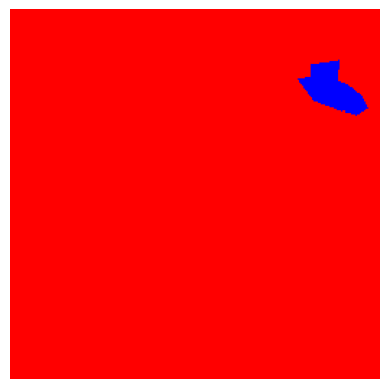

In [ ]:

mask = processed_masks[7]

# Display the image using Matplotlib
plt.imshow(mask)
plt.axis('off')  # Hide axis
plt.show()

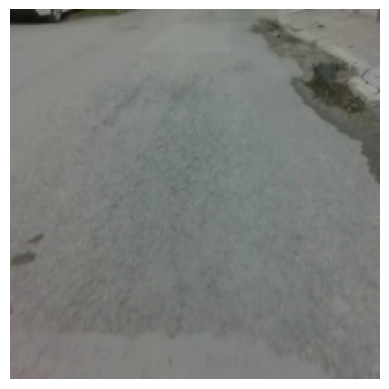

In [ ]:

img = images[7]

# Display the image using Matplotlib
plt.imshow(img)
plt.axis('off')  # Hide axis
plt.show()

In [ ]:
print(processed_masks.shape)
print(masks.shape)



(999, 256, 256, 3)
(999, 256, 256, 3)


In [ ]:
train_images, test_val_images, train_masks, test_val_masks = train_test_split(images, processed_masks, test_size=0.1, random_state=42)
test_images, val_images, test_masks, val_masks = train_test_split(test_val_images, test_val_masks, test_size=0.5, random_state=42)


In [ ]:
print(f"Training images shape: {train_images.shape}")
print(f"Training masks shape: {train_masks.shape}")
print(f"Validation images shape: {test_val_images.shape}")
print(f"Validation masks shape: {test_val_masks.shape}")

Training images shape: (899, 256, 256, 3)
Training masks shape: (899, 256, 256, 3)
Validation images shape: (100, 256, 256, 3)
Validation masks shape: (100, 256, 256, 3)


In [ ]:
#ONLY FOR TESTING VISUALIZATION
train_images, test_val_images = train_test_split(processed_images, test_size=0.2, random_state=42)
test_images, val_images = train_test_split(test_val_images, test_size=0.5, random_state=42)


In [ ]:
checkpointer = ModelCheckpoint(filepath='/content/drive/MyDrive/FYP/unet_mobilenetv2_4.h5', verbose=1, save_best_only=True)
model.fit(train_images, train_masks, epochs=10, batch_size=16, callbacks=[checkpointer], validation_data=(val_images, val_masks))


Epoch 1/10
57/57 [==============================] - ETA: 0s - loss: 0.0800 - accuracy: 0.9770
Epoch 1: val_loss improved from inf to 0.08314, saving model to /content/drive/MyDrive/FYP/unet_mobilenetv2_4.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


57/57 [==============================] - 87s 648ms/step - loss: 0.0800 - accuracy: 0.9770 - val_loss: 0.0831 - val_accuracy: 0.9796
Epoch 2/10
57/57 [==============================] - ETA: 0s - loss: 0.0634 - accuracy: 0.9805
Epoch 2: val_loss did not improve from 0.08314
57/57 [==============================] - 24s 421ms/step - loss: 0.0634 - accuracy: 0.9805 - val_loss: 0.0998 - val_accuracy: 0.9780
Epoch 3/10
57/57 [==============================] - ETA: 0s - loss: 0.0607 - accuracy: 0.9808
Epoch 3: val_loss did not improve from 0.08314
57/57 [==============================] - 24s 427ms/step - loss: 0.0607 - accuracy: 0.9808 - val_loss: 0.1196 - val_accuracy: 0.9775
Epoch 4/10
57/57 [==============================] - ETA: 0s - loss: 0.0607 - accuracy: 0.9812
Epoch 4: val_loss did not improve from 0.08314
57/57 [==============================] - 25s 430ms/step - loss: 0.0607 - accuracy: 0.9812 - val_loss: 0.1452 - val_accuracy: 0.9697
Epoch 5/10
57/57 [==============================]

In [ ]:
model = load_model('/content/drive/MyDrive/FYP/model_weights14.h5')

In [ ]:
image = imageio.imread("70.jpg")

In [ ]:
images = []
target_shape = (256, 256)
img_resized = resize(image, target_shape, preserve_range=True, anti_aliasing=True)
images.append(img_resized)
images = np.array(images, dtype=np.uint8)
prediction = model.predict(images)

1/1 [==============================] - 3s 3s/step


In [ ]:
prediction = model.predict(test_images)

2/2 [==============================] - 25s 9s/step


In [ ]:
processed_predictions = post_process_predictions(prediction)


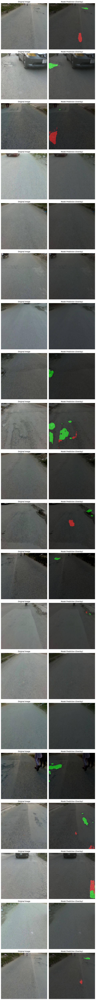

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Limit the number of images plotted at once
max_images_to_plot = 20  # Adjust this number as needed
num_images = min(len(test_images), max_images_to_plot)

fig, axs = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

for i in range(num_images):
    # Plot original image
    axs[i, 0].imshow(test_images[i])
    axs[i, 0].axis('off')
    axs[i, 0].set_title('Original Image')

    # Create an overlay of the original image and the segmented mask
    overlay = test_images[i].copy()
    mask = processed_predictions[i]

    # Blend the mask with the original image using alpha blending
    alpha = 0.5
    blended = ((1 - alpha) * overlay + alpha * mask).astype(np.uint8)

    # Plot the overlaid image
    axs[i, 1].imshow(blended)
    axs[i, 1].axis('off')
    axs[i, 1].set_title('Model Prediction (Overlay)')

plt.tight_layout()
plt.show()


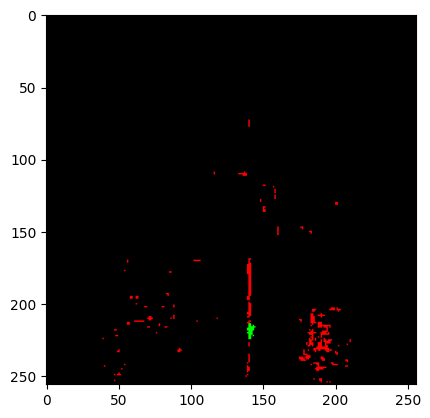

In [ ]:
plt.imshow(processed_predictions[0])

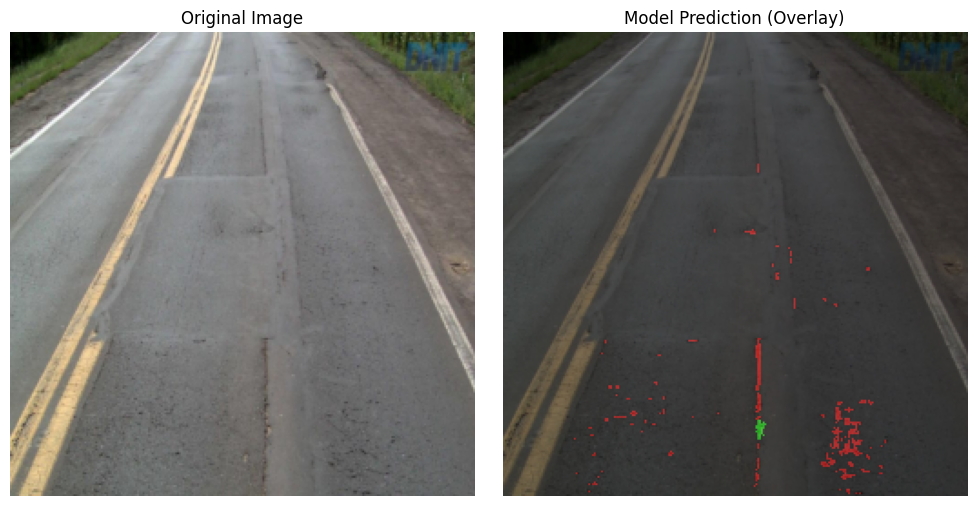

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Limit the number of images plotted at once
max_images_to_plot = 20  # Adjust this number as needed
num_images = min(len(images), max_images_to_plot)

fig, axs = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

# Handle the case where num_images is 1
if num_images == 1:
    axs = [axs]

for i in range(num_images):
    # Plot original image
    axs[i][0].imshow(images[i])
    axs[i][0].axis('off')
    axs[i][0].set_title('Original Image')

    # Create an overlay of the original image and the segmented mask
    overlay = images[i].copy()
    mask = processed_predictions[i]

    # Blend the mask with the original image using alpha blending
    alpha = 0.5
    blended = ((1 - alpha) * overlay + alpha * mask).astype(np.uint8)

    # Plot the overlaid image
    axs[i][1].imshow(blended)
    axs[i][1].axis('off')
    axs[i][1].set_title('Model Prediction (Overlay)')

plt.tight_layout()
plt.show()


In [ ]:
def preprocess_frame(frame):
    frame_resized = cv2.resize(frame, (256, 256))  # Assuming the model input size is 256x256
    frame_normalized = frame_resized / 255.0  # Normalize the frame
    return np.expand_dims(frame_normalized, axis=0)  # Add batch dimension

In [ ]:
import numpy as np
import cv2
from keras.models import load_model
from skimage.transform import resize
import matplotlib.pyplot as plt
import imageio
from google.colab.patches import cv2_imshow

# Define the post-processing function
def post_process_predictions(predictions):
    processed_predictions = []
    for pred_mask in predictions:
        class_labels = np.argmax(pred_mask, axis=-1)
        colors = np.array([[0, 0, 0], [255, 0, 0], [0, 255, 0]])  # Background (black), Cracks (red), Potholes (green)
        pred_rgb = colors[class_labels]
        processed_predictions.append(pred_rgb)
    return np.array(processed_predictions)

# Load the trained model
model = load_model('/content/drive/MyDrive/FYP/model_weights14.h5')

# Define the video path and capture the video
input_video_path = 'sample_video.mp4'
output_video_path = 'output_video2.mp4'
cap = cv2.VideoCapture(input_video_path)

# Get video properties
fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
target_shape = (256, 256)  # Model's expected input size

# Define the codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_video_path, fourcc, fps, (width, height))
print(fps)
# Process the video frame by frame
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Preprocess the frame
    img_resized = resize(frame, target_shape, preserve_range=True, anti_aliasing=True)
    img_resized = np.expand_dims(img_resized, axis=0).astype(np.uint8)

    # Predict the segmentation mask
    prediction = model.predict(img_resized)
    processed_predictions = post_process_predictions(prediction)

    # Post-process the prediction and overlay on the original frame
    overlay = frame.copy()
    mask_resized = resize(processed_predictions[0], (height, width), preserve_range=True, anti_aliasing=True).astype(np.uint8)
    alpha = 0.5
    blended = cv2.addWeighted(overlay, 1 - alpha, mask_resized, alpha, 0)

    # Write the frame to the output video
    out.write(blended)

    # Optionally display the frame for debugging
    # cv2_imshow(blended)

# Release everything if job is finished
cap.release()
out.release()
cv2.destroyAllWindows()

# Display the output video in Colab
from IPython.display import HTML
from base64 import b64encode

def display_video(path):
    mp4 = open(path, 'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    return HTML(f"""
        <video width=600 controls>
            <source src="{data_url}" type="video/mp4">
        </video>
    """)

display_video(output_video_path)


25
1/1 [==============================] - 0s 40ms/step


In [ ]:
import numpy as np
import cv2
from keras.models import load_model
from skimage.transform import resize
import matplotlib.pyplot as plt
import imageio
from google.colab.patches import cv2_imshow
from IPython.display import HTML
from base64 import b64encode

# Define the post-processing function
def post_process_predictions(predictions):
    processed_predictions = []
    for pred_mask in predictions:
        class_labels = np.argmax(pred_mask, axis=-1)
        processed_predictions.append(class_labels)
    return np.array(processed_predictions)

# Load the trained model
model = load_model('/content/drive/MyDrive/FYP/model_weights14.h5')

# Define the video path and capture the video
input_video_path = 'road.mp4'
output_video_path = 'output_video.mp4'
mask_video_path = 'mask_output_video.mp4'
cap = cv2.VideoCapture(input_video_path)

# Get video properties
fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
target_shape = (256, 256)  # Model's expected input size

# Define the codec and create VideoWriter objects
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_video_path, fourcc, fps, (width, height))
mask_out = cv2.VideoWriter(mask_video_path, fourcc, fps, (width, height))
print(fps)

# Process the video frame by frame
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Preprocess the frame
    img_resized = resize(frame, target_shape, preserve_range=True, anti_aliasing=True)
    img_resized = np.expand_dims(img_resized, axis=0).astype(np.uint8)

    # Predict the segmentation mask
    prediction = model.predict(img_resized)
    processed_predictions = post_process_predictions(prediction)

    # Post-process the prediction and overlay on the original frame
    overlay = frame.copy()
    mask_resized = resize(processed_predictions[0], (height, width), preserve_range=True, anti_aliasing=True).astype(np.uint8)
    mask_rgb = cv2.cvtColor(mask_resized, cv2.COLOR_GRAY2RGB)  # Convert single channel to 3 channels
    alpha = 0.5
    blended = cv2.addWeighted(overlay, 1 - alpha, mask_rgb * 255, alpha, 0)  # Multiply mask_rgb by 255 for visualization

    # Write the frame to the output videos
    out.write(blended)
    mask_out.write(mask_rgb * 255)  # Save binary mask video

    # Optionally display the frame for debugging
    # cv2_imshow(blended)

# Release everything if job is finished
cap.release()
out.release()
mask_out.release()
cv2.destroyAllWindows()

# Display the output video in Colab
def display_video(path):
    mp4 = open(path, 'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    return HTML(f"""
        <video width=600 controls>
            <source src="{data_url}" type="video/mp4">
        </video>
    """)

display_video(output_video_path)
display_video(mask_video_path)


In [ ]:
!wget www.filebin.net/qbyj597tthsaex37/sample_video.mp4

--2024-07-30 08:02:52--  http://www.filebin.net/qbyj597tthsaex37/sample_video.mp4
Resolving www.filebin.net (www.filebin.net)... 88.99.137.18, 2a01:4f8:10a:2156::2
Connecting to www.filebin.net (www.filebin.net)|88.99.137.18|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://www.filebin.net/qbyj597tthsaex37/sample_video.mp4 [following]
--2024-07-30 08:02:53--  https://www.filebin.net/qbyj597tthsaex37/sample_video.mp4
Connecting to www.filebin.net (www.filebin.net)|88.99.137.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://filebin.net/qbyj597tthsaex37/sample_video.mp4 [following]
--2024-07-30 08:02:53--  https://filebin.net/qbyj597tthsaex37/sample_video.mp4
Resolving filebin.net (filebin.net)... 88.99.137.18, 2a01:4f8:10a:2156::2
Connecting to filebin.net (filebin.net)|88.99.137.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://s3.filebin.net/filebi